### Load Libraries

In [1]:
import gc
import glob
import h5py
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import numpy as np
import os
import pandas as pd
import pickle
import pylab as pl
import random
import regex
import seaborn as sns
import shap
shap.initjs()
import spacy
import statistics
import string
import sys
np.set_printoptions(threshold=sys.maxsize)
import time
import timeit
import xgboost as xgb

from apex import amp
from collections import Counter
from hyperopt import fmin, tpe, hp, anneal, Trials
from itertools import islice
from scipy.cluster.vq import whiten
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score, mean_squared_error, precision_score, recall_score
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.svm import SVC
from tqdm import tqdm, tqdm_notebook

import torch
import torch.nn as nn
import torchtext
from torchtext.data import Field, BucketIterator, TabularDataset, Iterator
from torch.optim import Adam, RMSprop
from torch.optim.lr_scheduler import ReduceLROnPlateau

seed = 42
np.random.seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

SAMPLE_SIZE = 5000
GENERATE_SAMPLES = False
GENERATE_KEYS = False
EXTRACT_FEATS = False
SEARCH_RF_PARAMS = False
SEARCH_XGB_PARAMS = False
SEARCH_ENSEMBLE_PARAMS = False
AUTHORS = [
    'Andrew Lang',
    'Anthony Trollope',
    'Baronness Orczy',
    'Benjamin Disraeli',
    'Bret Harte',
    'Charles Darwin',
    'Charles Dickens',
    'Charles Kingsley',
    'Charlotte Mary Yonge',
    'Daniel Defoe',
]

nlp = spacy.load('en_core_web_sm')
nlp.max_length = 2000000

### Generate Samples

In [2]:
if GENERATE_SAMPLES:
    paths = glob.glob('labeled-text/*')
    paths.sort()
    all_titles = [fn.split('/')[-1].split('___')[1][:-4] for fn in paths]
    all_authors = [fn.split('/')[-1].split('___')[0] for fn in paths]
    all_texts = [
        open(path, errors='ignore', mode='r')\
        .read().replace('\n', ' ').replace('\r', '')
             for path in paths
    ]
    
    author_texts = {author:{'texts': [], 'train': [], 'val': [], 'test': []} for author in AUTHORS}
    for author, text in zip(all_authors, all_texts):
        if author in AUTHORS:
            author_texts[author]['texts'].append(text)
    
    train_df = pd.DataFrame(columns=['author', 'text'])
    val_df = pd.DataFrame(columns=['author', 'text'])
    test_df = pd.DataFrame(columns=['author', 'text'])
    for author in tqdm_notebook(AUTHORS):
        num_of_texts = len(author_texts[author]['texts'])
        train_count = int(0.8 * num_of_texts)
        val_count = int(0.5 * (num_of_texts - train_count))
        test_count = num_of_texts - train_count - val_count
        
        author_texts[author]['train'] = author_texts[author]['texts'][:train_count]
        author_texts[author]['val'] = author_texts[author]['texts'][train_count:train_count+val_count]
        author_texts[author]['test'] = author_texts[author]['texts'][train_count+val_count:]
        
        for doc in nlp.pipe(author_texts[author]['train'], disable=['tagger', 'parser', 'ner']):
            train_df = pd.concat([train_df] + [pd.DataFrame(
                    [[author, ''.join(token.text_with_ws for token in doc[idx:idx+SAMPLE_SIZE])]], columns=['author', 'text']
                ) for idx in range(0, len(doc)-SAMPLE_SIZE, SAMPLE_SIZE)], ignore_index=True)
        for doc in nlp.pipe(author_texts[author]['val'], disable=['tagger', 'parser', 'ner']):
            val_df = pd.concat([val_df] + [pd.DataFrame(
                    [[author, ''.join(token.text_with_ws for token in doc[idx:idx+SAMPLE_SIZE])]], columns=['author', 'text']
                ) for idx in range(0, len(doc)-SAMPLE_SIZE, SAMPLE_SIZE)], ignore_index=True)
        for doc in nlp.pipe(author_texts[author]['test'], disable=['tagger', 'parser', 'ner']):
            test_df = pd.concat([test_df] + [pd.DataFrame(
                    [[author, ''.join(token.text_with_ws for token in doc[idx:idx+SAMPLE_SIZE])]], columns=['author', 'text']
                ) for idx in range(0, len(doc)-SAMPLE_SIZE, SAMPLE_SIZE)], ignore_index=True)
    
    train_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-train.csv', index=False)
    val_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-val.csv', index=False)
    test_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-test.csv', index=False)

### Generate Keys for Count Features

In [3]:
if GENERATE_KEYS:
    MAX_SAMPLES = 25
    paths = glob.glob('saved-data/spacy-docs/*')
    paths.sort()
    authors = set([fn.split('/')[-1].split('_')[0] for fn in paths])
    
    char_bigram_counter = Counter()
    char_trigram_counter = Counter()
    word_unigram_counter = Counter()
    word_bigram_counter = Counter()
    word_trigram_counter = Counter()
    pos_unigram_counter = Counter()
    pos_bigram_counter = Counter()
    pos_trigram_counter = Counter()
    
    for author in tqdm_notebook(authors):
        paths = glob.glob(f'saved-data/spacy-docs/{author}_*')
        sample_count = MAX_SAMPLES if len(paths) > MAX_SAMPLES else len(paths)
        for path in random.sample(paths, sample_count):
            # read data from file
            try:
                with open(path, 'rb') as fp:
                    doc = pickle.load(fp)
                    word_unigrams = list()
                    for token in doc:
                        if token.is_punct == False:
                            word_unigrams.append(token.text.lower())
                    char_unigrams = [char.lower() for char in doc.text]
                    pos_unigrams = [token.pos_ for token in doc]
            except:
                print(f'Recieved EoF in {path}: Continuing . . .')
                continue

            # extract character bigrams and trigrams
            char_bigrams = [f'{tup[0]}{tup[1]}' for tup in \
                            zip(char_unigrams, islice(char_unigrams, 1, None))]
            char_bigram_counter += Counter(char_bigrams)
            char_trigrams = [f'{tup[0]}{tup[1]}{tup[2]}' for tup in \
                             zip(char_unigrams, islice(char_unigrams, 1, None), islice(char_unigrams, 2, None))]
            char_trigram_counter += Counter(char_trigrams)

            # extract word and part-of-speech unigrams/bigrams/trigrams
            word_unigram_counter += Counter(word_unigrams)
            word_bigrams = [f'{tup[0]}_{tup[1]}' for tup in \
                            zip(word_unigrams, islice(word_unigrams, 1, None))]
            word_bigram_counter += Counter(word_bigrams)
            word_trigrams = [f'{tup[0]}_{tup[1]}_{tup[2]}' for tup in \
                             zip(word_unigrams, islice(word_unigrams, 1, None), islice(word_unigrams, 2, None))]
            word_trigram_counter += Counter(word_trigrams)
            pos_unigram_counter += Counter(pos_unigrams)
            pos_bigrams = [f'{tup[0]}_{tup[1]}' for tup in \
                           zip(pos_unigrams, islice(pos_unigrams, 1, None))]
            pos_bigram_counter += Counter(pos_bigrams)
            pos_trigrams = [f'{tup[0]}_{tup[1]}_{tup[2]}' for tup in \
                            zip(pos_unigrams, islice(pos_unigrams, 1, None), islice(pos_unigrams, 2, None))]
            pos_trigram_counter += Counter(pos_trigrams)
    
    # save to file
    with open(f'saved-data/counter/char_bigram_counter.pickle', 'wb') as fp:
        pickle.dump(char_bigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/char_trigram_counter.pickle', 'wb') as fp:
        pickle.dump(char_trigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/word_unigram_counter.pickle', 'wb') as fp:
        pickle.dump(word_unigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/word_bigram_counter.pickle', 'wb') as fp:
        pickle.dump(word_bigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/word_trigram_counter.pickle', 'wb') as fp:
        pickle.dump(word_trigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/pos_unigram_counter.pickle', 'wb') as fp:
        pickle.dump(pos_unigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/pos_bigram_counter.pickle', 'wb') as fp:
        pickle.dump(pos_bigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'saved-data/counter/pos_trigram_counter.pickle', 'wb') as fp:
        pickle.dump(pos_trigram_counter, fp, protocol=pickle.HIGHEST_PROTOCOL)

### Read In Exported Count Data

In [4]:
char_bigram_counter = Counter()
char_trigram_counter = Counter()
word_unigram_counter = Counter()
word_bigram_counter = Counter()
word_trigram_counter = Counter()
pos_unigram_counter = Counter()
pos_bigram_counter = Counter()
pos_trigram_counter = Counter()

with open(f'saved-data/counter/char_bigram_counter.pickle', 'rb') as fp:
    char_bigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/char_trigram_counter.pickle', 'rb') as fp:
    char_trigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/word_unigram_counter.pickle', 'rb') as fp:
    word_unigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/word_bigram_counter.pickle', 'rb') as fp:
    word_bigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/word_trigram_counter.pickle', 'rb') as fp:
    word_trigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/pos_unigram_counter.pickle', 'rb') as fp:
    pos_unigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/pos_bigram_counter.pickle', 'rb') as fp:
    pos_bigram_counter += Counter(dict(pickle.load(fp)))
with open(f'saved-data/counter/pos_trigram_counter.pickle', 'rb') as fp:
    pos_trigram_counter += Counter(dict(pickle.load(fp)))

char_bigram_keys100 = [tup[0] for tup in char_bigram_counter.most_common(100)]
char_trigram_keys100 = [tup[0] for tup in char_trigram_counter.most_common(100)]
word_unigram_keys100 = [tup[0] for tup in word_unigram_counter.most_common(100)]
word_bigram_keys100 = [tup[0] for tup in word_bigram_counter.most_common(100)]
word_trigram_keys100 = [tup[0] for tup in word_trigram_counter.most_common(100)]
pos_unigram_keys15 = [tup[0] for tup in pos_unigram_counter.most_common(100)]
pos_bigram_keys100 = [tup[0] for tup in pos_bigram_counter.most_common(100)]
pos_trigram_keys100 = [tup[0] for tup in pos_trigram_counter.most_common(100)]

train_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-train.csv')
val_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-val.csv')
test_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-test.csv')
train_df['set'] = 'train'
val_df['set'] = 'val'
test_df['set'] = 'test'
data_df = pd.concat([train_df, val_df, test_df], ignore_index=True)

In [5]:
data_sample_counts = list()
for author in AUTHORS:
    data_sample_counts.append(data_df[data_df['author'] == author].shape[0])

print(dict(zip(AUTHORS, data_sample_counts)))

{'Andrew Lang': 891, 'Anthony Trollope': 2243, 'Baronness Orczy': 349, 'Benjamin Disraeli': 407, 'Bret Harte': 632, 'Charles Darwin': 676, 'Charles Dickens': 1427, 'Charles Kingsley': 793, 'Charlotte Mary Yonge': 1613, 'Daniel Defoe': 548}


In [6]:
paths = glob.glob('saved-data/spacy-docs/*')
paths.sort()
df = pd.DataFrame()
df['author'] = [fn.split('/')[-1].split('_')[0] for fn in paths]
df['author'].value_counts()

Anthony Trollope        1881
Charlotte Mary Yonge    1316
Charles Dickens         1145
Andrew Lang              736
Charles Kingsley         648
Charles Darwin           562
Bret Harte               524
Daniel Defoe             478
Benjamin Disraeli        339
Baronness Orczy          289
Name: author, dtype: int64

### Extract and Preprocess Feature Data

In [7]:
def get_vectorized_counts(token_list, vocab_list):
    fvs = np.zeros((1, len(vocab_list)), np.float64)
    token_count = {key: 0 for key in vocab_list}
    for token in token_list:
        if token in token_count.keys():
            token_count[token] += 1
    return np.reshape(np.array(list(token_count.values()), np.float64), (1, -1))

def get_word_list(token_list):
    words = list()
    for token in token_list:
        if token.is_punct == False:
            words.append(token.text.lower())
    return words

def get_feature_vectors(doc):
    """
    Returns fvs_lex, fvs_wordlen, fvs_punct,
        fvs_char_bigrams, fvs_char_trigrams,
        fvs_word_unigrams, fvs_word_bigrams, fvs_word_trigrams, fvs_funcs,
        fvs_pos_unigrams, fvs_pos_bigrams, fvs_pos_trigrams
    """
    # extract lexical features
    fvs_lex = np.zeros((1, 6), np.float64)
    num_sents = len([_ for sent in doc.sents])
    sent_token_lens = [len(sent) for sent in doc.sents]
    sent_word_lens = [len(get_word_list(sent)) for sent in doc.sents]
    fvs_lex[0, 0] = sum(sent_token_lens) / float(num_sents) # average tokens per sentence
    fvs_lex[0, 1] = statistics.stdev(sent_token_lens) # standard deviation of tokens in sentence
    fvs_lex[0, 2] = len(set([token.text.lower() for token in doc])) / len(doc) # token diversity
    fvs_lex[0, 3] = sum(sent_word_lens) / float(num_sents) # average words per sentence
    fvs_lex[0, 4] = statistics.stdev(sent_word_lens) # standard deviation of tokens in sentence
    fvs_lex[0, 5] = len(set(get_word_list(doc))) / len(get_word_list(doc)) # word diversity
        
    # extract word length averages
    lower_bound = 2
    upper_bound = 10
    valid_count = 0
    fvs_wordlen = np.zeros((1, upper_bound - lower_bound + 1), np.float64)
    for token in doc:
        if len(token.text) >= lower_bound and len(token.text) <= upper_bound:
            valid_count += 1
            fvs_wordlen[0, len(token.text) - lower_bound] += 1
    for i in range(upper_bound - lower_bound + 1):
        fvs_wordlen[0, i] /= valid_count
        
    # extract punctuation count averages
    fvs_punct = np.zeros((1, 5), np.float64)
    fvs_punct[0, 0] = doc.text.count(',') / float(num_sents) # commas per sentence
    fvs_punct[0, 1] = doc.text.count(';') / float(num_sents) # semicolons per sentence
    fvs_punct[0, 2] = doc.text.count(':') / float(num_sents) # colons per sentence
    fvs_punct[0, 3] = doc.text.count('?') / float(num_sents) # question marks per sentence
    fvs_punct[0, 4] = doc.text.count('!') / float(num_sents) # exclamation marks per sentence
    
    # extract character bigram counts
    char_unigrams = [c for c in doc.text.lower()]
    token_list = [f'{tup[0]}{tup[1]}' for tup in \
                  zip(char_unigrams, islice(char_unigrams, 1, None))]
    fvs_char_bigrams = get_vectorized_counts(token_list, char_bigram_keys100)
    
    # extract character trigram counts
    token_list = [f'{tup[0]}{tup[1]}{tup[2]}' for tup in \
                  zip(char_unigrams, islice(char_unigrams, 1, None), islice(char_unigrams, 2, None))]
    fvs_char_trigrams = get_vectorized_counts(token_list, char_trigram_keys100)
    
    # extract word unigram counts
    word_unigrams = get_word_list(doc)
    fvs_word_unigrams = get_vectorized_counts(word_unigrams, word_unigram_keys100)
    
    # extract word bigram counts
    token_list = [f'{tup[0]}_{tup[1]}' for tup in \
                  zip(word_unigrams, islice(word_unigrams, 1, None))]
    fvs_word_bigrams = get_vectorized_counts(token_list, word_bigram_keys100)
    
    # extract word trigram counts
    token_list = [f'{tup[0]}_{tup[1]}_{tup[2]}' for tup in \
                  zip(word_unigrams, islice(word_unigrams, 1, None), islice(word_unigrams, 2, None))]
    fvs_word_trigrams = get_vectorized_counts(token_list, word_trigram_keys100)
    
    # extract function word counts
    fvs_funcs = np.zeros((1, 10), np.float64)
    article_keys = ['a', 'an', 'the']
    demonstrative_keys = ['that', 'this', 'those', 'these']
    possessive_pronoun_keys = ['my', 'your', 'their', 'our', 'ours', 'whose', 'his', 'hers', 'its', 'which']
    quantifier_keys = ['all', 'any', 'both', 'enough', 'few', 'little', 'lot', 'many', 'most', 'much', 'none', 'quite', 'rather', 'really', 'several', 'some', 'somewhat', 'too', 'very']
    conjunction_keys = ['and', 'but', 'for', 'yet', 'neither', 'or', 'so', 'although', 'however', 'as', 'because', 'before']
    preposition_keys = ['in', 'of', 'between', 'on', 'with', 'by', 'at', 'without', 'through', 'over', 'across', 'around', 'into', 'within']
    pronoun_keys = ['she', 'they', 'he', 'it', 'him', 'her', 'you', 'me', 'anybody', 'somebody', 'someone', 'anyone']
    auxiliary_verb_keys = ['be', 'is', 'am', 'are', 'have', 'has', 'do', 'does', 'did', 'get', 'got', 'was', 'were']
    modal_keys = ['may', 'might', 'can', 'could', 'will', 'would', 'shall', 'should']
    question_keys = ['how', 'where', 'what', 'when', 'why', 'who']
    
    for token in doc:
        if token.text in article_keys:
            fvs_funcs[0, 0] += 1
        elif token.text in demonstrative_keys:
            fvs_funcs[0, 1] += 1
        elif token.text in possessive_pronoun_keys:
            fvs_funcs[0, 2] += 1
        elif token.text in quantifier_keys:
            fvs_funcs[0, 3] += 1
        elif token.text in conjunction_keys:
            fvs_funcs[0, 4] += 1
        elif token.text in preposition_keys:
            fvs_funcs[0, 5] += 1
        elif token.text in pronoun_keys:
            fvs_funcs[0, 6] += 1
        elif token.text in auxiliary_verb_keys:
            fvs_funcs[0, 7] += 1
        elif token.text in modal_keys:
            fvs_funcs[0, 8] += 1
        elif token.text in question_keys:
            fvs_funcs[0, 9] += 1
    
    # extract part-of-speech unigram counts
    pos_unigram_keys = [
        'VERB', 'PUNCT', 'NOUN', 'DET', 'ADP', 'PRON', 'ADV', 'ADJ', 'PROPN', 'CCONJ',
        'PART', 'NUM', 'INTJ', 'X', 'SYM'
    ]
    pos_unigrams = [token.pos_ for token in doc]
    fvs_pos_unigrams = get_vectorized_counts(pos_unigrams, pos_unigram_keys)
    
    # extract part-of-speech bigram counts
    token_list = [f'{tup[0]}_{tup[1]}' for tup in \
                  zip(pos_unigrams, islice(pos_unigrams, 1, None))]
    fvs_pos_bigrams = get_vectorized_counts(token_list, pos_bigram_keys100)
    
    # extract part-of-speech trigram counts
    token_list = [f'{tup[0]}_{tup[1]}_{tup[2]}' for tup in \
                  zip(pos_unigrams, islice(pos_unigrams, 1, None), islice(pos_unigrams, 2, None))]
    fvs_pos_trigrams = get_vectorized_counts(token_list, pos_trigram_keys100)
    
    return fvs_lex, fvs_wordlen, fvs_punct, \
        fvs_char_bigrams, fvs_char_trigrams, \
        fvs_word_unigrams, fvs_word_bigrams, fvs_word_trigrams, fvs_funcs, \
        fvs_pos_unigrams, fvs_pos_bigrams, fvs_pos_trigrams

In [8]:
if EXTRACT_FEATS:
    assert sum(data_sample_counts) == len(data_df['text'].tolist())
    X = np.zeros((sum(data_sample_counts), 745), np.float64)
    for idx, text in tqdm_notebook(enumerate(data_df['text'].tolist())):
        doc = nlp(text, disable=['ner'])

        fvs_lex, fvs_wordlen, fvs_punct, \
        fvs_char_bigrams, fvs_char_trigrams, \
        fvs_word_unigrams, fvs_word_bigrams, fvs_word_trigrams, fvs_funcs, \
        fvs_pos_unigrams, fvs_pos_bigrams, fvs_pos_trigrams = get_feature_vectors(doc)

        X[idx, 0:6] = fvs_lex
        X[idx, 6:15] = fvs_wordlen
        X[idx, 15:20] = fvs_punct
        X[idx, 20:120] = fvs_char_bigrams
        X[idx, 120:220] = fvs_char_trigrams
        X[idx, 220:320] = fvs_word_unigrams
        X[idx, 320:420] = fvs_word_bigrams
        X[idx, 420:520] = fvs_word_trigrams
        X[idx, 520:530] = fvs_funcs
        X[idx, 530:545] = fvs_pos_unigrams
        X[idx, 545:645] = fvs_pos_bigrams
        X[idx, 645:745] = fvs_pos_trigrams
    
    with h5py.File(f'saved-data/features/{len(AUTHORS)}-author-x.h5', 'w') as hf:
        hf.create_dataset('X',  data=X)

In [9]:
with h5py.File(f'saved-data/features/{len(AUTHORS)}-author-x.h5', 'r') as hf:
    X = hf['X'][:]

In [10]:
def visualize_feature_space(data, sample_idxs, group_counts, authors):
    plt.figure(figsize=(12,6))
    plots = list()
    colors = [
        'maroon','red','orangered','chocolate','saddlebrown',
        'darkorange','darkorange','gold','yellow','olivedrab',
        'yellowgreen','darkgreen','greenyellow','springgreen','aquamarine',
        'turquoise','cyan','deepskyblue','dodgerblue','navy',
        'blue','blueviolet','darkviolet','purple','magenta'
    ]
    
    idx = 0
    pca_2d = PCA(n_components=2).fit_transform(data)
    for group_idx, counts in enumerate(group_counts):
        for i in range(counts):
            scatter = plt.scatter(pca_2d[sample_idxs[idx], 0], pca_2d[sample_idxs[idx], 1],
                                  c=colors[group_idx], marker='o', alpha=0.5)
            idx += 1
        plots.append(scatter)
    
    plt.legend(plots, authors)
    plt.title('Samples in 2D Feature Space')
    plt.show()

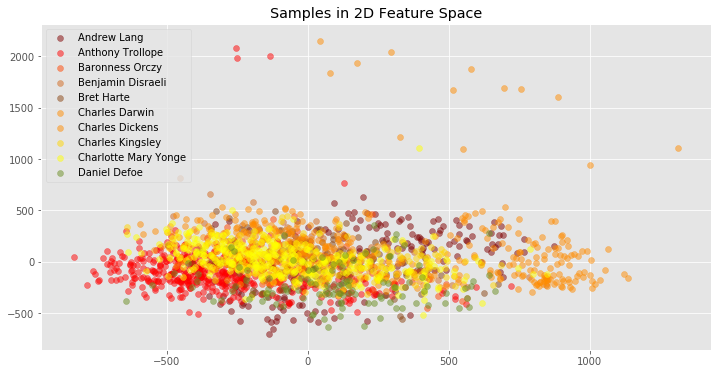

In [11]:
subsample_df = data_df.sample(n=2000).sort_values('author')
subsample_idxs = subsample_df.index.values.tolist()
subsample_group_counts = subsample_df.groupby('author').agg(lambda x: x.shape[0])['text'].values.tolist()
subsample_authors = subsample_df['author'].unique().tolist()
visualize_feature_space(X, subsample_idxs, subsample_group_counts, subsample_authors)

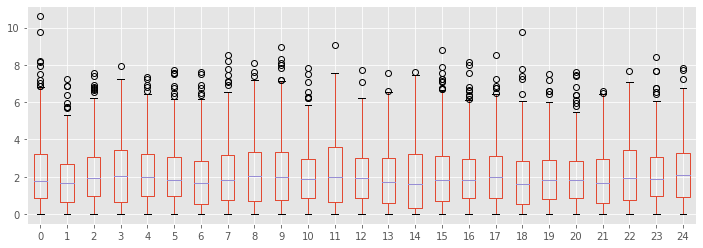

In [12]:
# scaling for unsupervised clustering
cluster_scaler = MinMaxScaler()
X_scaled = cluster_scaler.fit_transform(X)
X_scaled_whiten = whiten(X_scaled)

df = pd.DataFrame(X_scaled_whiten[np.random.choice(X_scaled_whiten.shape[0], 25, replace=False), :])
df.T.boxplot(figsize=(12,4))
plt.show()

In [13]:
# split data for supervised training, validation, and test predictions
X_train = X[:train_df.shape[0]]
X_val = X[train_df.shape[0]:train_df.shape[0]+val_df.shape[0]]
X_test = X[train_df.shape[0]+val_df.shape[0]:]

le = LabelEncoder()
le.fit(data_df['author'])
y_train = le.transform(train_df['author'])
y_val = le.transform(val_df['author'])
y_test = le.transform(test_df['author'])

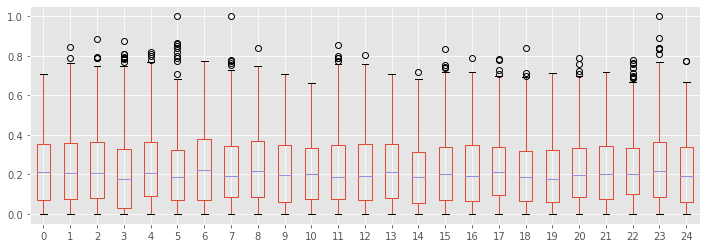

In [14]:
# column-wise normalization
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

df = pd.DataFrame(X_train_scaled[np.random.choice(X_train_scaled.shape[0], 25, replace=False), :])
df.T.boxplot(figsize=(12,4))
plt.show()

### K-Means Classification

In [15]:
def predict_authors(fvs, n):
    """
    Cluster using the k-means algorithm
    """
    km = KMeans(n_clusters=n, init='k-means++', n_init=50, random_state=seed, n_jobs=-1)
    km.fit(fvs)
    
    return km

def get_consistency_scores(labels, sample_counts, authors=None):
    i = 0
    scores = list()
    if authors is None:
        authors = ['' for count in sample_counts]
    
    for idx, sample_count in enumerate(sample_counts):
        counts = Counter(labels[i:i+sample_count])
        mode, mode_count = counts.most_common(1)[0]
        scores.append((mode, mode_count / sample_count, authors[idx]))
        i += sample_count
    
    return scores

def visualize_kmeans(data, authors):
    reduced_data = PCA(n_components=2).fit_transform(data)
    kmeans = predict_authors(reduced_data, len(authors))

    # Step size of the mesh. Decrease to increase the quality of the VQ.
    h = .02  # point in the mesh [x_min, x_max]x[y_min, y_max].

    # Plot the decision boundary. For that, we will assign a color to each
    x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
    y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Obtain labels for each point in mesh. Use last trained model.
    Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.figure(1, figsize=(12,6))
    plt.clf()
    plt.imshow(Z, interpolation='nearest',
               extent=(xx.min(), xx.max(), yy.min(), yy.max()),
               cmap=plt.cm.Paired,
               aspect='auto', origin='lower')

    plt.plot(reduced_data[:, 0], reduced_data[:, 1], 'k.', markersize=2)
    
    # Plot the centroids as a white X
    centroids = kmeans.cluster_centers_
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='x', s=169, linewidths=3,
                color='w', zorder=10)
    plt.title('K-Means Clustering')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xticks(())
    plt.yticks(())
    plt.show()

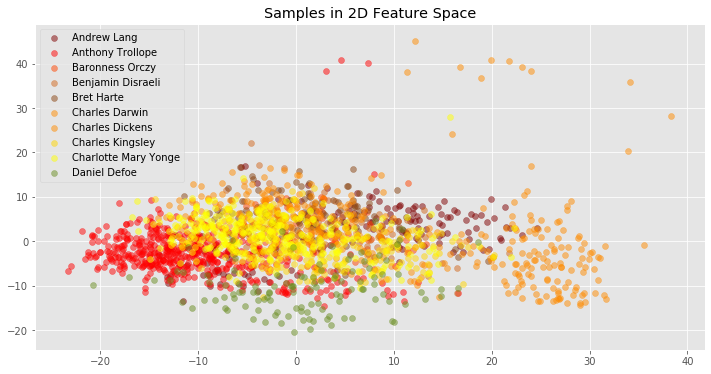

In [16]:
visualize_feature_space(X_scaled_whiten, subsample_idxs, subsample_group_counts, subsample_authors)

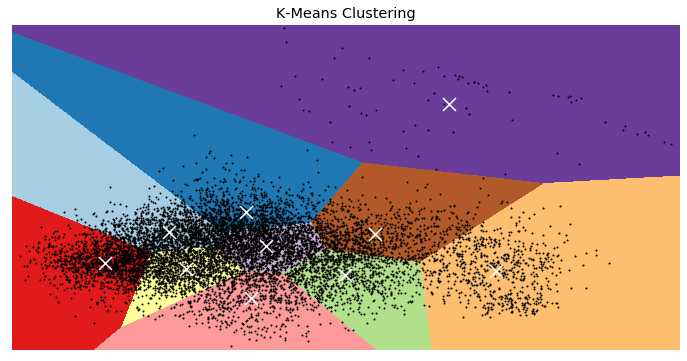

In [17]:
visualize_kmeans(X_scaled_whiten, AUTHORS)

In [18]:
get_consistency_scores(predict_authors(X_scaled_whiten, len(data_sample_counts)).labels_, data_sample_counts, AUTHORS)

[(5, 0.4287317620650954, 'Andrew Lang'),
 (4, 0.5376727596968346, 'Anthony Trollope'),
 (8, 0.5530085959885387, 'Baronness Orczy'),
 (7, 0.8869778869778869, 'Benjamin Disraeli'),
 (2, 0.6265822784810127, 'Bret Harte'),
 (2, 0.5931952662721893, 'Charles Darwin'),
 (6, 0.3917309039943938, 'Charles Dickens'),
 (6, 0.3442622950819672, 'Charles Kingsley'),
 (4, 0.2727836329820211, 'Charlotte Mary Yonge'),
 (8, 0.26094890510948904, 'Daniel Defoe')]

### Supervised ML Visualization Functions

In [19]:
def plot_confusion_matrix(y_test, test_preds, test_score='(missing)'):
    cm = confusion_matrix(y_test, test_preds)

    plt.figure(figsize=(8,8))
    sns.heatmap(cm, annot=True, fmt=".0f", linewidths=.01, square=True, cmap='Blues_r')
    plt.ylabel('Actual label')
    plt.xlabel('Predicted label')
    all_sample_title = 'Accuracy Score: {0}'.format(test_score)
    plt.title(all_sample_title, size=15)

    # Fix for graphics error:
    b, t = plt.ylim()
    b += 0.5
    t -= 0.5
    plt.ylim(b, t)
    plt.show()

### Logistic Regression Model

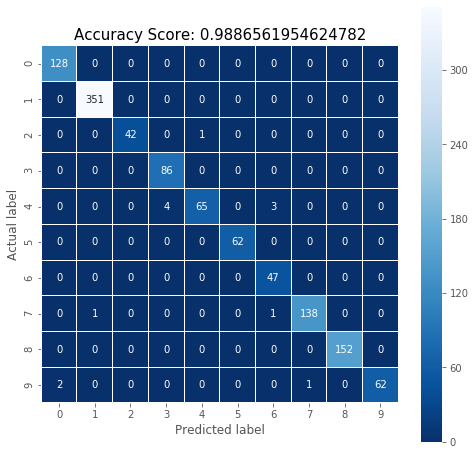

In [20]:
logreg_model = LogisticRegression(
    penalty='l2',
    C=1000,
    random_state=np.random.RandomState(seed),
    max_iter=1000,
    solver='lbfgs',
    multi_class='multinomial',
    n_jobs=-1,
    l1_ratio=None
).fit(X_train_scaled, y_train)

logreg_test_preds = logreg_model.predict(X_test_scaled)
logreg_test_score = logreg_model.score(X_test_scaled, y_test)
plot_confusion_matrix(y_test, logreg_test_preds, logreg_test_score)

### SVM Model

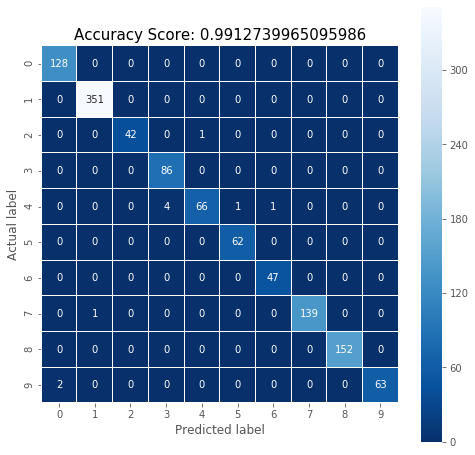

In [21]:
svc_model = SVC(
    C=100,
    kernel='rbf',
    gamma='auto',
    shrinking=True,
    probability=True,
    tol=0.001,
    cache_size=200,
    verbose=False,
    max_iter=-1,
    decision_function_shape='ovr',
    random_state=np.random.RandomState(seed)
).fit(X_train_scaled, y_train)

svc_test_preds = svc_model.predict(X_test_scaled)
svc_test_score = svc_model.score(X_test_scaled, y_test)
plot_confusion_matrix(y_test, svc_test_preds, svc_test_score)

### Random Forest Model

In [22]:
def get_rf_model(params):
    return RandomForestClassifier(
        n_estimators=int(params['n_estimators']),
        max_depth=int(params['max_depth']),
        min_samples_split=int(params['min_samples_split']),
        min_samples_leaf=int(params['min_samples_leaf']),
        max_features=params['max_features'],
        bootstrap=params['bootstrap'],
        n_jobs=-1,
        random_state=np.random.RandomState(seed)
    )

def get_rf_val_neg_f1(params):
    rf_model = get_rf_model(params)
    rf_model.fit(X_train_scaled, y_train)
    return f1_score(y_val, rf_model.predict(X_val_scaled), average='micro') * -1

if SEARCH_RF_PARAMS:
    space = {
        'n_estimators': hp.quniform('n_estimators', 200, 2000, 50),
        'max_depth': hp.quniform('max_depth', 10, 100, 5),
        'min_samples_split': hp.quniform('min_samples_split', 2, 10, 1),
        'min_samples_leaf': hp.quniform('min_samples_leaf', 1, 4, 1),
        'max_features': hp.choice('max_features', ['auto', 'sqrt']),
        'bootstrap': hp.choice('bootstrap', [True, False])
    }
    
    trials = Trials()
    start = timeit.default_timer()
    rf_params = fmin(
        fn=get_rf_val_neg_f1,
        space=space,
        algo=tpe.suggest,
        max_evals=150,
        trials=trials,
        rstate=np.random.RandomState(seed)
    )
    stop = timeit.default_timer()
    print(f'Time: {round((stop - start) / 60, 4)} minutes')
    
    rf_params['n_estimators'] = int(rf_params['n_estimators'])
    rf_params['max_depth'] = int(rf_params['max_depth'])
    rf_params['min_samples_split'] = int(rf_params['min_samples_split'])
    rf_params['min_samples_leaf'] = int(rf_params['min_samples_leaf'])
    rf_params['max_features'] = 'auto' if rf_params['max_features'] == 0 else 'sqrt'
    rf_params['bootstrap'] = True if rf_params['bootstrap'] == 0 else False
    with open(f'saved-data/models/rf-params-{len(AUTHORS)}-authors.pickle', 'wb') as fp:
        pickle.dump(rf_params, fp, protocol=pickle.HIGHEST_PROTOCOL)

In [23]:
with open(f'saved-data/models/rf-params-{len(AUTHORS)}-authors.pickle', 'rb') as fp:
    rf_params = pickle.load(fp)

rf_params

{'bootstrap': False,
 'max_depth': 30,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 4,
 'n_estimators': 850}

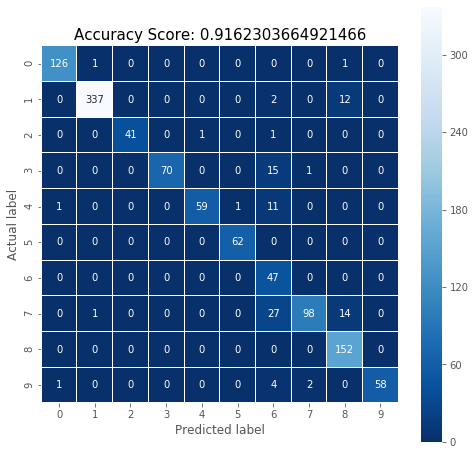

In [24]:
rf_model = get_rf_model(rf_params)
rf_model.fit(X_train_scaled, y_train)
rf_test_preds = rf_model.predict(X_test_scaled)
rf_test_score = rf_model.score(X_test_scaled, y_test)
plot_confusion_matrix(y_test, rf_test_preds, rf_test_score)

### K-Nearest Neighbors Model

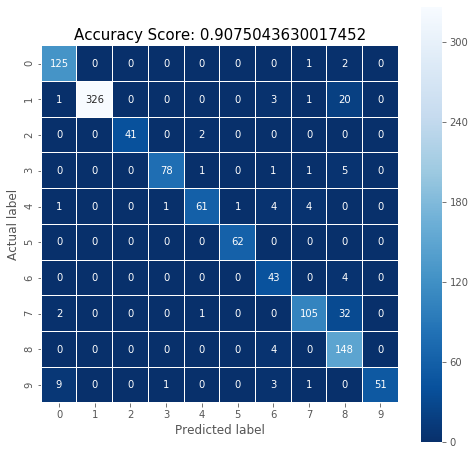

In [25]:
knn_model = KNeighborsClassifier(
    n_neighbors=5,
    weights='uniform',
    algorithm='auto',
    leaf_size=30,
    p=2,
    metric='minkowski',
    metric_params=None,
    n_jobs=-1,
).fit(X_train_scaled, y_train)

knn_test_preds = knn_model.predict(X_test_scaled)
knn_test_score = knn_model.score(X_test_scaled, y_test)
plot_confusion_matrix(y_test, knn_test_preds, knn_test_score)

### XGBoost Model

In [26]:
D_train = xgb.DMatrix(X_train_scaled, label=y_train)
D_val = xgb.DMatrix(X_val_scaled, label=y_val)
D_test = xgb.DMatrix(X_test_scaled, label=y_test)
y_target = None

In [27]:
def get_model(params):
    params['max_depth'] = int(params['max_depth'])
    params['min_child_weight'] = int(params['min_child_weight'])
    return xgb.train(params, D_train, num_boost_round=1000, verbose_eval=False,
                     evals=[(D_val,'Val')], early_stopping_rounds=25)

def get_xgb_preds(params):
    model = get_model(params)
    preds = model.predict(D_val)
    best_preds = np.asarray([np.argmax(line) for line in preds])
    return best_preds

def get_xgb_f1(params):
    return f1_score(y_target, get_xgb_preds(params), average='micro') * -1

In [28]:
if SEARCH_XGB_PARAMS:
    space = {
        'eta': hp.uniform('eta', 0.01, 0.3),
        'max_depth': hp.quniform('max_depth', 3, 10, 1),
        'min_child_weight': hp.quniform('min_child_weight', 1, 6, 1),
        'gamma': hp.uniform('gamma', 0.0, 1.0),
        'subsample': hp.uniform('subsample', 0.6, 0.9),
        'colsample_bytree': hp.uniform('colsample_bytree', 0.6, 0.9),
        'reg_alpha': hp.uniform('reg_alpha', 0.0, 0.1),
        'objective': hp.choice('objective', ['multi:softprob']),  
        'num_class': hp.choice('num_class', [len(data_sample_counts)])
    }

    y_target = y_val
    max_evals = 350
    trials = Trials()
    start = timeit.default_timer()
    xgb_params = fmin(
        fn=get_xgb_f1,
        space=space,
        algo=anneal.suggest,
        max_evals=max_evals,
        trials=trials,
        rstate=np.random.RandomState(seed)
    )
    stop = timeit.default_timer()
    print(f'Time: {round((stop - start) / 60, 4)} minutes')
    
    xgb_params['objective'] = 'multi:softprob'
    xgb_params['num_class'] = len(data_sample_counts)
    with open(f'saved-data/models/xgb-params-{len(AUTHORS)}-authors.pickle', 'wb') as fp:
        pickle.dump(xgb_params, fp, protocol=pickle.HIGHEST_PROTOCOL)

In [29]:
with open(f'saved-data/models/xgb-params-{len(AUTHORS)}-authors.pickle', 'rb') as fp:
    xgb_params = pickle.load(fp)
    
xgb_params

{'colsample_bytree': 0.6369822055219225,
 'eta': 0.20523365388622672,
 'gamma': 0.39333703887231547,
 'max_depth': 3,
 'min_child_weight': 4,
 'num_class': 10,
 'objective': 'multi:softprob',
 'reg_alpha': 0.03465926851835531,
 'subsample': 0.8084674065127795}

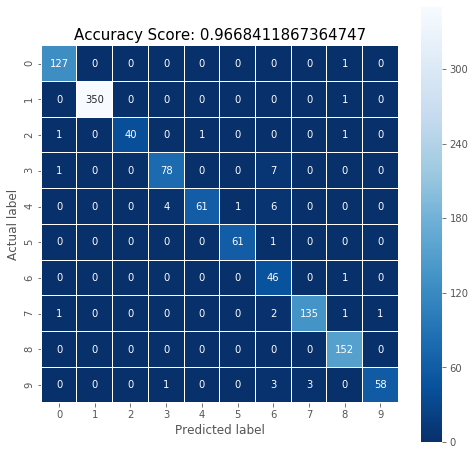

In [30]:
y_target = y_test
xgb_model = get_model(xgb_params)
xgb_test_preds = xgb_model.predict(D_test)
xgb_test_preds = np.asarray([np.argmax(line) for line in xgb_test_preds])
plot_confusion_matrix(y_test, xgb_test_preds, accuracy_score(y_test, xgb_test_preds))

In [31]:
gain_dict = get_model(xgb_params).get_score(importance_type='gain')
gain_keys = [f'f{i}' for i in range(X.shape[1])]
gain_vals = [0 if key not in gain_dict.keys() else gain_dict[key] for key in gain_keys]
gain_vals = [val / sum(gain_vals) for val in gain_vals]

agg_gain_vals = list()
agg_gain_vals.append(sum(gain_vals[0:6]))
agg_gain_vals.append(sum(gain_vals[6:15]))
agg_gain_vals.append(sum(gain_vals[15:20]))
agg_gain_vals.append(sum(gain_vals[20:120]))
agg_gain_vals.append(sum(gain_vals[120:220]))
agg_gain_vals.append(sum(gain_vals[220:320]))
agg_gain_vals.append(sum(gain_vals[320:420]))
agg_gain_vals.append(sum(gain_vals[420:520]))
agg_gain_vals.append(sum(gain_vals[520:530]))
agg_gain_vals.append(sum(gain_vals[530:545]))
agg_gain_vals.append(sum(gain_vals[545:645]))
agg_gain_vals.append(sum(gain_vals[645:745]))

agg_gain_keys = [
    'Lexical', 'Word Length', 'Punctuation', 'Char Bigram', 'Char Trigram',
    'Word Unigram', 'Word Bigram', 'Word Trigram', 'Func Words',
    'PoS Unigram', 'PoS Bigram', 'PoS Trigram'
]

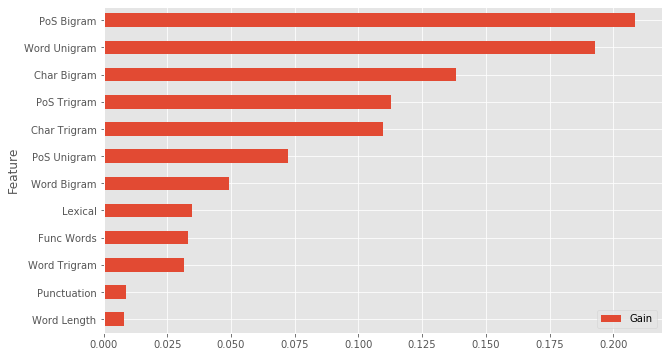

In [32]:
df = pd.DataFrame()
df['Feature'] = agg_gain_keys
df['Gain'] = agg_gain_vals
df.sort_values('Gain', ascending=True)[['Feature','Gain']].plot.barh('Feature', 'Gain', figsize=(10, 6))
plt.show()

In [33]:
feat_names = [f'lex_{i}' for i in range(6)]
feat_names.extend([f'wordlen_{i}' for i in range(15-len(feat_names))])
feat_names.extend([f'punct_{i}' for i in range(20-len(feat_names))])
feat_names.extend([f'char_bi_{i}' for i in range(120-len(feat_names))])
feat_names.extend([f'char_tri_{i}' for i in range(220-len(feat_names))])
feat_names.extend([f'word_uni_{i}' for i in range(320-len(feat_names))])
feat_names.extend([f'word_bi_{i}' for i in range(420-len(feat_names))])
feat_names.extend([f'word_tri_{i}' for i in range(520-len(feat_names))])
feat_names.extend([f'funcs_{i}' for i in range(530-len(feat_names))])
feat_names.extend([f'pos_uni_{i}' for i in range(545-len(feat_names))])
feat_names.extend([f'pos_bi_{i}' for i in range(645-len(feat_names))])
feat_names.extend([f'pos_tri_{i}' for i in range(745-len(feat_names))])

In [34]:
explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X_train_scaled)
shap.force_plot(explainer.expected_value[0], shap_values[0][0,:], X_train_scaled[0,:], feature_names=feat_names)

In [35]:
X_train_scaled_sub = X_train_scaled[:1000, :]
shap_values_sub = explainer.shap_values(X_train_scaled_sub)
shap.force_plot(explainer.expected_value[0], shap_values_sub[0][:,:], X_train_scaled_sub, feature_names=feat_names)

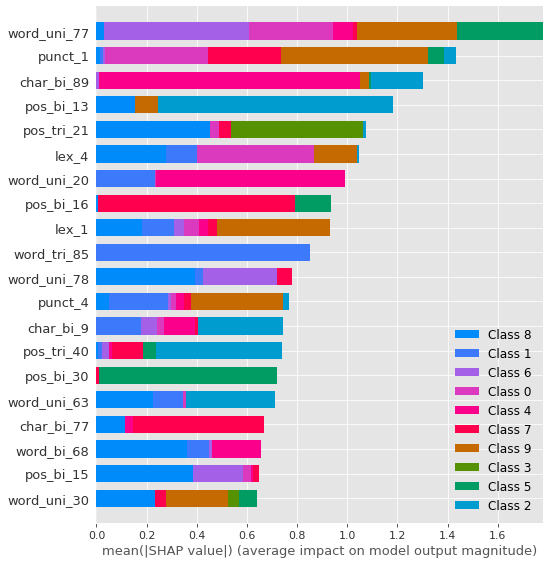

In [36]:
shap.summary_plot(shap_values, X_train_scaled, feature_names=feat_names)

### GRU Neural Network Model

In [37]:
def one_hot(labels, vocab_size):
    one_hot = torch.zeros(labels.size(0), labels.size(1), vocab_size).to(DEVICE)
    return one_hot.scatter_(dim=2, index=labels.unsqueeze(2), value=1)

class GruWordTokenClassifier(nn.Module):
    def __init__(self, vocab_size, hidden_size, num_layers, output_size, drop_prob, is_bidir):
        super(GruWordTokenClassifier, self).__init__()
        
        self.vocab_size = vocab_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.output_size = output_size
        self.drop_prob = drop_prob
        self.is_bidir = is_bidir
        
        self.gru = nn.GRU(vocab_size, hidden_size, num_layers, batch_first=True,
                          dropout=drop_prob, bidirectional=is_bidir)
        
        self.dropout = nn.Dropout(drop_prob)
        
        if is_bidir:
            self.fc = nn.Linear(hidden_size * 2, output_size)
        else:
            self.fc = nn.Linear(hidden_size, output_size)
            
        self.softmax = nn.LogSoftmax(dim=1)
        
        self.init_weights()

    def init_weights(self):
        initrange = 0.5
        self.fc.weight.data.uniform_(-initrange, initrange)
        self.fc.bias.data.zero_()
    
    def init_hidden(self, batch_size):
        weight = next(self.parameters()).data
        if self.is_bidir:
            hidden = weight.new(self.num_layers * 2, batch_size, self.hidden_size).zero_().to(DEVICE)
        else:
            hidden = weight.new(self.num_layers, batch_size, self.hidden_size).zero_().to(DEVICE)
        return hidden
    
    def forward(self, x):
        batch_size, seq_len = x.shape
        if seq_len > SAMPLE_SIZE:
            x = x[:, 0:SAMPLE_SIZE]
            seq_len = x.shape[1]
        
        x_oh = one_hot(x, self.vocab_size)
        hidden = self.init_hidden(batch_size)
        
        out, hidden = self.gru(x_oh, hidden)
        out = out.transpose(0,1)
        out = out[-1, :, :]
        out = self.dropout(out)
        
        out = self.fc(out)
        out = self.softmax(out)
        
        return out, hidden

In [38]:
def tokenizer(text):
    return [tok.text for tok in nlp.tokenizer(text)]

BATCH_SIZE = 2
NN_SAMPLE_SIZE = 200
DEVICE = torch.device('cuda:0')
TEXT = Field(sequential=True, tokenize=tokenizer, lower=True, batch_first=True)
LABEL = Field(sequential=False, batch_first=True)

train_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-train.csv')
val_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-val.csv')
test_df = pd.read_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-test.csv')
train_df = train_df[['text', 'author']]
val_df = val_df[['text', 'author']]
test_df = test_df[['text', 'author']]
train_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-nn-train.csv', index=False)
val_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-nn-val.csv', index=False)
test_df.to_csv(f'saved-data/csv/{SAMPLE_SIZE}-token-nn-test.csv', index=False)

train_td, val_td, test_td = TabularDataset.splits(
    path='saved-data/csv/', train=f'{NN_SAMPLE_SIZE}-token-train.csv',
    validation=f'{SAMPLE_SIZE}-token-nn-val.csv', test=f'{SAMPLE_SIZE}-token-nn-test.csv',
    format='csv', skip_header=True, fields=[('text', TEXT), ('label', LABEL)])

TEXT.build_vocab(train_td, min_freq=5)
text_vocab = TEXT.vocab
LABEL.build_vocab(train_td)
label_vocab = LABEL.vocab

train_iter, val_iter, test_iter = Iterator.splits(
    (train_td, val_td, test_td),
    sort_key=lambda x: x,
    shuffle=False,
    sort=False,
    sort_within_batch=False,
    batch_sizes=(BATCH_SIZE, BATCH_SIZE, BATCH_SIZE),
    device=DEVICE)

In [39]:
def get_nn_acc(model, tt_iter):
    acc = 0
    
    model.eval()
    for data in tqdm_notebook(tt_iter):
        with torch.no_grad():
            inputs, labels = data.text.to(DEVICE), data.label.to(DEVICE)
            output, hidden = model(inputs)
            acc += (output.argmax(1) == labels).sum().item()
    model.train()
    
    return acc / len(tt_iter.dataset.examples)

def get_nn_preds(model, tt_iter):
    nn_preds = None
    
    model.eval()
    for data in tt_iter:
        with torch.no_grad():
            inputs, labels = data.text.to(DEVICE), data.label.to(DEVICE)
            output, hidden = model(inputs)
            output = output[:, 1:]  # remove torchtext <unk> column
            output = output / output.sum(0)  # scale for probability
            nn_preds = torch.cat((nn_preds, output), 0) if nn_preds is not None else output
    model.train()
    
    nn_preds = torch.cat((
        torch.index_select(nn_preds, 1, torch.tensor(3, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(0, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(9, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(8, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(6, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(5, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(2, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(4, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(1, device=DEVICE)).to(DEVICE),
        torch.index_select(nn_preds, 1, torch.tensor(7, device=DEVICE)).to(DEVICE)
    ), dim=1).to(DEVICE)
    
    return nn_preds.cpu().numpy()

In [40]:
gru_model = GruWordTokenClassifier(
    vocab_size=len(TEXT.vocab), hidden_size=512, num_layers=3,
    output_size=len(AUTHORS)+1, drop_prob=0.5, is_bidir=False).to(DEVICE)
optimizer = Adam(gru_model.parameters(), eps=1e-4, weight_decay=1e-5)
gru_model, optimizer = amp.initialize(gru_model, optimizer, opt_level='O1', keep_batchnorm_fp32=None, loss_scale='dynamic')
gru_model.load_state_dict(torch.load('./saved-data/models/gru-v4-final-state-dict.pt'))

print(f'Accuracy = {get_nn_acc(gru_model, test_iter)}')

Selected optimization level O1:  Insert automatic casts around Pytorch functions and Tensor methods.

Defaults for this optimization level are:
enabled                : True
opt_level              : O1
cast_model_type        : None
patch_torch_functions  : True
keep_batchnorm_fp32    : None
master_weights         : None
loss_scale             : dynamic
Processing user overrides (additional kwargs that are not None)...
After processing overrides, optimization options are:
enabled                : True
opt_level              : O1
cast_model_type        : None
patch_torch_functions  : True
keep_batchnorm_fp32    : None
master_weights         : None
loss_scale             : dynamic



Accuracy = 0.9075043630017452


### Ensemble of All Supervised Models

In [41]:
def ensemble_val_neg_acc(params):
    logreg_val_preds = logreg_model.predict_proba(X_val_scaled)
    svc_val_preds = svc_model.predict_proba(X_val_scaled)
    rf_val_preds = rf_model.predict_proba(X_val_scaled)
    knn_val_preds = knn_model.predict_proba(X_val_scaled)
    xgb_val_preds = xgb_model.predict(D_val)
    gru_val_preds = get_nn_preds(gru_model, val_iter)
    
    ensemble_val_preds = np.add(logreg_val_preds * params['logreg'], svc_val_preds * params['svm'])
    ensemble_val_preds = np.add(ensemble_val_preds, rf_val_preds * params['rf'])
    ensemble_val_preds = np.add(ensemble_val_preds, knn_val_preds * params['knn'])
    ensemble_val_preds = np.add(ensemble_val_preds, xgb_val_preds * params['gbt'])
    ensemble_val_preds = np.add(ensemble_val_preds, gru_val_preds * params['nn'])
    ensemble_val_votes = np.asarray([np.argmax(line) for line in ensemble_val_preds])
    return accuracy_score(y_val, ensemble_val_votes) * -1

def get_ensemble_acc(params, X, y, tt_iter=None):
    logreg_preds = logreg_model.predict_proba(X)
    svc_preds = svc_model.predict_proba(X)
    rf_preds = rf_model.predict_proba(X)
    knn_preds = knn_model.predict_proba(X)
    D = xgb.DMatrix(X, label=y)
    xgb_preds = xgb_model.predict(D)
    gru_preds = get_nn_preds(gru_model, tt_iter)
    
    ensemble_preds = np.add(logreg_preds * params['logreg'], svc_preds * params['svm'])
    ensemble_preds = np.add(ensemble_preds, rf_preds * params['rf'])
    ensemble_preds = np.add(ensemble_preds, knn_preds * params['knn'])
    ensemble_preds = np.add(ensemble_preds, xgb_preds * params['gbt'])
    ensemble_preds = np.add(ensemble_preds, gru_preds * params['nn'])
    ensemble_votes = np.asarray([np.argmax(row) for row in ensemble_preds])
    return accuracy_score(y, ensemble_votes)

In [42]:
if SEARCH_ENSEMBLE_PARAMS:
    space = {
        'logreg': hp.uniform('logreg', 0.0, 1.0),
        'svm': hp.uniform('svm', 0.0, 1.0),
        'rf': hp.uniform('rf', 0.0, 1.0),
        'knn': hp.uniform('knn', 0.0, 1.0),
        'gbt': hp.uniform('gbt', 0.0, 1.0),
        'nn': hp.uniform('nn', 0.0, 1.0),
    }

    max_evals = 150
    trials = Trials()
    start = timeit.default_timer()
    ensemble_params = fmin(
        fn=ensemble_val_neg_acc,
        space=space,
        algo=tpe.suggest,
        max_evals=max_evals,
        trials=trials,
        rstate=np.random.RandomState(seed)
    )
    stop = timeit.default_timer()
    print(f'Time: {round((stop - start) / 60, 4)} minutes')
    
    with open(f'saved-data/models/ensemble-params-{len(AUTHORS)}-authors.pickle', 'wb') as fp:
        pickle.dump(ensemble_params, fp, protocol=pickle.HIGHEST_PROTOCOL)

In [43]:
with open(f'saved-data/models/ensemble-params-{len(AUTHORS)}-authors.pickle', 'rb') as fp:
    ensemble_params = pickle.load(fp)
    
ensemble_params

{'knn': 0.46573916040839664,
 'logreg': 0.6221129770039313,
 'rf': 0.09852330646893954,
 'svm': 0.4876069750230143,
 'gbt': 0.22281669816901195,
 'nn': 0.05}

In [44]:
print(f'Validation Set Prediction Accuracy: {get_ensemble_acc(ensemble_params, X_val_scaled, y_val, val_iter)}')
print(f'Test Set Prediction Accuracy......: {get_ensemble_acc(ensemble_params, X_test_scaled, y_test, test_iter)}')

Validation Set Prediction Accuracy: 0.9923518164435946
Test Set Prediction Accuracy......: 0.9912739965095986
